<a href="https://colab.research.google.com/github/larregui/IST718-Project/blob/main/UFO_Maps.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# God Bless Dave Fisher-Hickey!  
Reference: https://www.kaggle.com/daveianhickey/how-to-folium-for-maps-heatmaps-time-data/

# Import Libraries

In [2]:
import pandas as pd #data frame operations
import numpy as np #arrays and math functions

#from scipy.stats import uniform #for training and test splits
#import statsmodels.api as sm  # statistical models (including regression)
#import statsmodels.formula.api as smf  # R-like model specification

import matplotlib.pyplot as plt #2D plotting
import seaborn as sns #seaborn for plotting
#from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator #for wordclouds
import folium #for maps
from folium import Marker #for maps
from folium.plugins import MarkerCluster #for maps
from folium import Choropleth
from folium.plugins import HeatMap
from folium import plugins

#from sklearn.linear_model import LinearRegression
#import plotly.graph_objs as go
#from plotly import tools
#from plotly.offline import iplot, init_notebook_mode

#Import Datasets

In [3]:
ufo = pd.read_csv("/content/newufo.csv")
air=pd.read_csv("/content/drive/MyDrive/Datasets/us-airports.csv")
mil=pd.read_csv("/content/drive/MyDrive/Datasets/US Military.csv")

In [4]:
#change datatype for the following columns
ufo["latitude"] = pd.to_numeric(ufo["latitude"], errors="coerce")
ufo['datetime'] = (pd.to_datetime(ufo['datetime'], format='%Y/%m/%d'))
ufo['date posted'] = (pd.to_datetime(ufo['date posted'], format='%Y/%m/%d'))
#add column day
ufo['day'] = pd.DatetimeIndex(ufo['datetime']).day
#drop unnecessary columns
cols2drop=[ 'Unnamed: 0','duration (hours/min)','date posted']
ufo=ufo.drop(columns=cols2drop)

In [5]:
print(air.type.unique())
#large_airport
air = air[air.type == 'large_airport']
air.shape

['large_airport' 'medium_airport' 'small_airport' 'closed' 'seaplane_base'
 'heliport' 'balloonport']


(170, 23)

In [6]:
# Split coordinates into latitude and logitude
mil['Coordinates'] = mil['Coordinates'].apply(lambda x : x.split(sep = ','))
mil['latitude'] = mil['Coordinates'].apply(lambda x: x[0] )
mil['longtitude'] = mil['Coordinates'].apply(lambda x: x[1] )

#MAPS!

In [7]:
# Creating a function to visualise maps from a source of your choice
def embed_map(m, file_name):
    from IPython.display import IFrame
    m.save(file_name)
    return IFrame(file_name, width='100%', height='500px')

In [ ]:
us_map = folium.Map(location=[40,-99], zoom_start=4)
mc = MarkerCluster()

# Adding marker clusters of US UFO sightings
for idx, row in ufo.iterrows():
        mc.add_child(folium.Marker([row['latitude'], row['longitude']]))
        
us_map.add_child(mc)
#embed_map(us_map, 'www.ufoclusters.html')
us_map.save('ufoclusters.html')

In [ ]:
us_map = folium.Map(location=[40,-99], zoom_start=4)
mc = MarkerCluster()

# Adding the airport markers to the map
for idx, row in air.iterrows():
    Marker([row['latitude_deg'], row['longitude_deg']]).add_to(us_map)

# Adding marker clusters of US UFO sightings
for idx, row in ufo.iterrows():
        mc.add_child(folium.Marker([row['latitude'], row['longitude']]))
        
us_map.add_child(mc)
#embed_map(us_map, 'www.ufoandairports.html')
us_map.save('ufoandairports.html')

Text(0.5, 0, 'Airport distance (kilometers)')

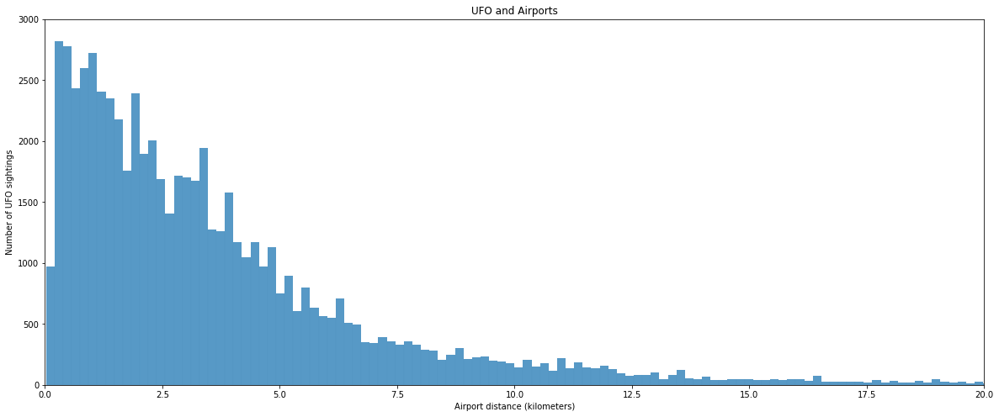

In [ ]:
plt.subplots(figsize=(20,8))
#plt.hist(ufo['airport_dist'],edgecolor='black')
ax = sns.histplot(ufo['airport_dist'])
# Set the limit for each axis
plt.xlim(0, 20)
plt.ylim(0, 3000)
plt.title('UFO and Airports')
plt.ylabel('Number of UFO sightings')
plt.xlabel('Airport distance (kilometers)')

In [ ]:
# Ensure you're handing it floats
mil['latitude'] = mil['latitude'].astype(float)
mil['longtitude'] = mil['longtitude'].astype(float)
us_map = folium.Map(location=[40,-99], zoom_start=4)
mc = MarkerCluster()

# Adding the military markers to the map
for idx, row in mil.iterrows():
    Marker([row['latitude'], row['longtitude']]).add_to(us_map)

# Adding marker clusters of US UFO sightings
for idx, row in ufo.iterrows():
        mc.add_child(folium.Marker([row['latitude'], row['longitude']]))
        
us_map.add_child(mc)
#embed_map(us_map, 'www.ufoandairports.html')
#us_map.save('ufomilitary.html')
us_map

Text(0.5, 0, 'Militaty base distance (kilometers)')

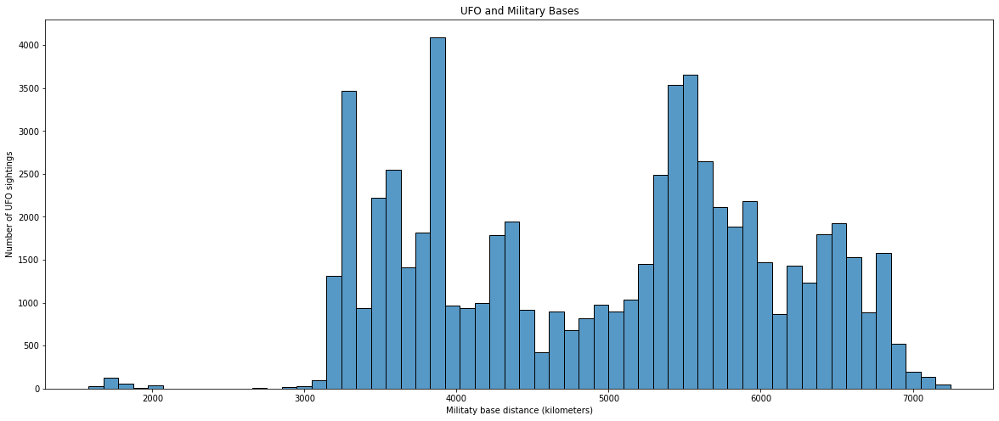

In [ ]:
plt.subplots(figsize=(20,8))
ax = sns.histplot(ufo['military_base_dist'], palette="PuBuGn")
#plt.hist(ufo['military_base_dist'],edgecolor='black', bins=9)
plt.title('UFO and Military Bases')
plt.ylabel('Number of UFO sightings')
plt.xlabel('Militaty base distance (kilometers)')

In [ ]:
dfmap = ufo.loc[:,['city','latitude','longitude']]
count = dfmap['city'].value_counts()
city = ufo['city']
count = pd.DataFrame(count,city)
count = count.rename(columns={' ': 'city','city': 'count'})
dfmap = dfmap.merge(count, on='city', how='left')
dfmap.drop_duplicates()


,city,latitude,longitude,count
0,san marcos,29.883056,-97.941111,36
36,edna,28.978333,-96.645833,3
39,kaneohe,21.418056,-157.803611,12
51,bristol,36.595000,-82.188889,70
121,norwalk,41.117500,-73.408333,51
...,...,...,...,...
3559724,lemitar,34.159722,-106.909722,1
3559751,double springs,34.146389,-87.402222,1
3560607,riverdale,39.099167,-76.536111,15
3561391,buffalo (west of; on highway 90 west),42.886389,-78.878611,1


In [ ]:
us_map = folium.Map(location=[40,-99], zoom_start=4)

# Ensure you're handing it floats
ufo['latitude'] = ufo['latitude'].astype(float)
ufo['longitude'] = ufo['longitude'].astype(float)

heat_df = ufo[['latitude', 'longitude']]
heat_df = heat_df.dropna(axis=0, subset=['latitude','longitude'])

# List comprehension to make out list of lists
heat_data = [[row['latitude'],row['longitude']] for index, row in heat_df.iterrows()]

# Plot it on the map
HeatMap(heat_data).add_to(us_map)

# Display the map
us_map
us_map.save('ufoheatmap.html')

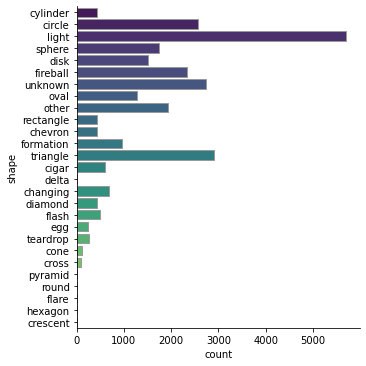

In [ ]:
sns.catplot(y=ufo["shape"], kind="count",
            palette="viridis", edgecolor=".6",
            data=ufo.sort_values("shape"))

In [ ]:
ufo.loc[ufo['shape'] == 'rectangle', 'shape'] ='geometric'
ufo.loc[ufo['shape'] == 'chevron', 'shape'] ='geometric'
ufo.loc[ufo['shape'] == 'triangle', 'shape'] ='geometric'
ufo.loc[ufo['shape'] == 'diamond', 'shape'] ='geometric'
ufo.loc[ufo['shape'] == 'cross', 'shape'] ='geometric'
ufo.loc[ufo['shape'] == 'delta', 'shape'] ='geometric'
ufo.loc[ufo['shape'] == 'hexagon', 'shape'] ='geometric'
ufo.loc[ufo['shape'] == 'pyramid', 'shape'] ='geometric'

ufo.loc[ufo['shape'] == 'changed', 'shape'] ='changing'
ufo.loc[ufo['shape'] == 'formation','shape'] ='changing'

ufo.loc[ufo['shape'] == 'unknown','shape'] ='other'

ufo.loc[ufo['shape'] == 'flash', 'shape'] ='light'
ufo.loc[ufo['shape'] == 'flare', 'shape'] ='light'

ufo.loc[ufo['shape'] == 'circle', 'shape'] ='disk'
ufo.loc[ufo['shape'] == 'oval','shape'] ='disk'
ufo.loc[ufo['shape'] == 'round','shape'] ='disk'

ufo.loc[ufo['shape'] == 'spere', 'shape'] ='ball'
ufo.loc[ufo['shape'] == 'fireball', 'shape'] ='ball'

ufo.loc[ufo['shape'] == 'teardrop', 'shape'] ='egg'

ufo.loc[ufo['shape'] == 'cigar', 'shape'] ='cylinder'
ufo.loc[ufo['shape'] == 'cone','shape'] ='cylinder'
ufo.loc[ufo['shape'] == 'crescent','shape'] ='cylinder'

#ufo

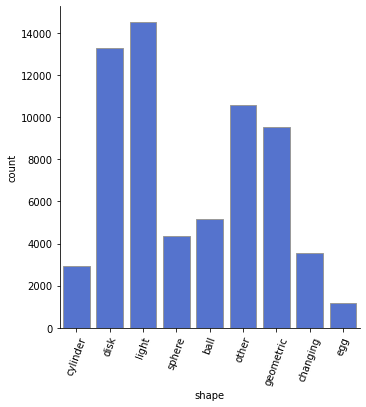

In [ ]:
s=sns.catplot(x=ufo["shape"], kind="count",
            color="royalblue", edgecolor=".6",
            data=ufo.sort_values("shape"))
s.set_xticklabels(rotation=70)
s.set_titles("Distribution of Shapes")


In [ ]:
# Long sighting - light
df_light = ufo[ufo['shape'] == 'geometric']

us_map1 = folium.Map(location=[40,-99], zoom_start=4)
mc = MarkerCluster()

# Adding marker clusters of US UFO sightings
for idx, row in df_light.iterrows():
        mc.add_child(folium.Marker([row['latitude'], row['longitude']]))
        
us_map1.add_child(mc)
#embed_map(us_map, 'www.ufoclusters.html')
us_map.save('ufocluster.html')

In [ ]:
us_map = folium.Map(location=[40,-99], zoom_start=4)

heat_df = df_light[['latitude', 'longitude']]
heat_df = heat_df.dropna(axis=0, subset=['latitude','longitude'])

# List comprehension to make out list of lists
heat_data = [[row['latitude'],row['longitude']] for index, row in heat_df.iterrows()]

# Plot it on the map
HeatMap(heat_data).add_to(us_map)

# Display the map
us_map


In [ ]:
# Long sighting - egg
df_egg = ufo[ufo['shape'] == 'egg']

us_map = folium.Map(location=[40,-99], zoom_start=4)
mc = MarkerCluster()

# Adding marker clusters of US UFO sightings
for idx, row in df_egg.iterrows():
        mc.add_child(folium.Marker([row['latitude'], row['longitude']]))
        
us_map.add_child(mc)
#embed_map(us_map, 'www.ufoclusters.html')

In [ ]:
us_map = folium.Map(location=[40,-99], zoom_start=4)

heat_df = df_egg[['latitude', 'longitude']]
heat_df = heat_df.dropna(axis=0, subset=['latitude','longitude'])

# List comprehension to make out list of lists
heat_data = [[row['latitude'],row['longitude']] for index, row in heat_df.iterrows()]

# Plot it on the map
HeatMap(heat_data).add_to(us_map)

# Display the map
us_map


In [ ]:
ufoa = ufo[ufo["duration (seconds)"] <= 4000]
ufo.describe()

,duration (seconds),latitude,longitude,year,month,military_base_dist,airport_dist,day
count,6.509900e+04,65101.000000,65101.000000,65101.000000,65101.000000,65101.000000,65101.000000,65101.000000
mean,5.801160e+03,38.357713,-95.711331,2004.091227,6.862014,4976.574659,4.468347,15.014332
std,4.045601e+05,5.570190,18.108948,10.384370,3.248196,1132.233000,32.126687,8.914664
min,1.000000e-02,17.967778,-176.658056,1910.000000,1.000000,1579.967092,0.022381,1.000000
25%,3.000000e+01,34.106389,-115.116667,2001.000000,4.000000,3869.685525,1.243761,7.000000
50%,1.800000e+02,38.968611,-90.065556,2007.000000,7.000000,5272.114644,2.755317,15.000000
75%,6.000000e+02,41.947500,-81.023056,2011.000000,10.000000,5858.575114,4.892205,22.000000
max,6.627600e+07,70.636944,-65.831667,2014.000000,12.000000,7246.990681,1680.207885,31.000000


Text(0.5, 0, 'Duration (seconds)')

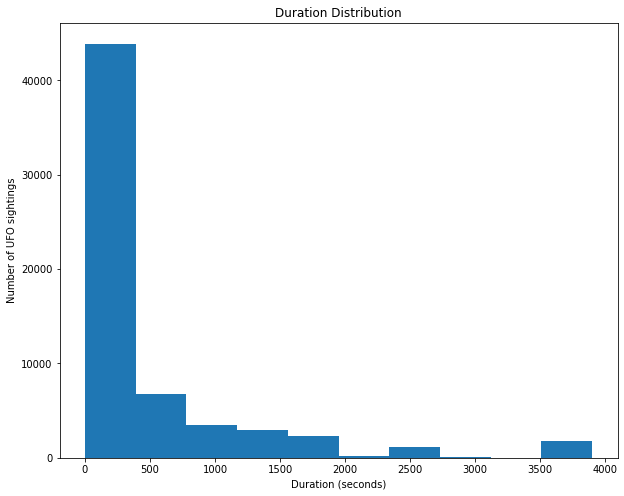

In [ ]:
plt.subplots(figsize=(10,8))
plt.hist(ufoa['duration (seconds)'])
plt.title('Duration Distribution')
plt.ylabel('Number of UFO sightings')
plt.xlabel('Duration (seconds)')

Text(0.5, 0, 'Duration (seconds)')

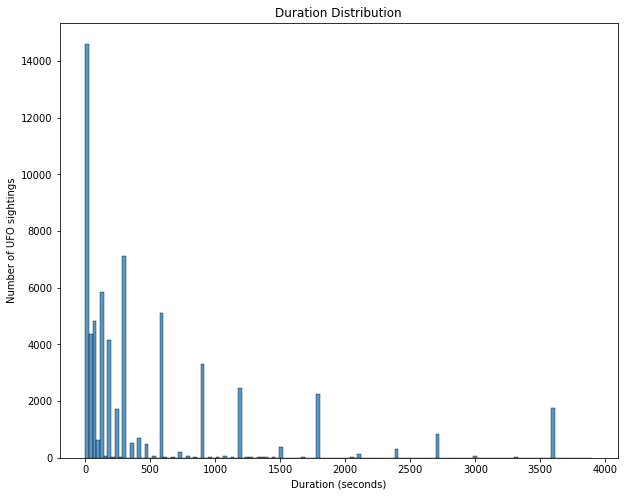

In [ ]:
plt.subplots(figsize=(10,8))
ax = sns.histplot(ufoa['duration (seconds)'])
# Set the limit for each axis
#plt.xlim(0, 20)
#plt.ylim(0, 3000)
plt.title('Duration Distribution')
plt.ylabel('Number of UFO sightings')
plt.xlabel('Duration (seconds)')

In [ ]:
ufob = ufo[ufo["duration (seconds)"] >= 86400]

In [ ]:
us_map = folium.Map(location=[40,-99], zoom_start=4)

heat_df = ufob[['latitude', 'longitude']]
heat_df = heat_df.dropna(axis=0, subset=['latitude','longitude'])

# List comprehension to make out list of lists
heat_data = [[row['latitude'],row['longitude']] for index, row in heat_df.iterrows()]

# Plot it on the map
HeatMap(heat_data).add_to(us_map)

# Display the map
us_map

(array([   0,    1,    2, ..., 1353, 1354, 1355]),
 <a list of 1356 Text major ticklabel objects>)

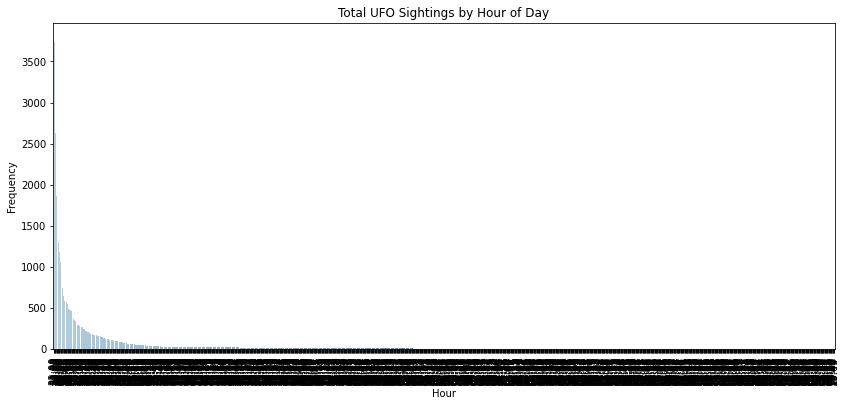

In [79]:
time_data = ufo['time'].value_counts()

time_data = pd.DataFrame(data=time_data)
plt.figure(figsize=(14,6))
plt.title('Total UFO Sightings by Hour of Day')
sns.barplot(x=time_data.index, y=time_data['time'], palette='Blues_d')
plt.xlabel('Hour')
plt.ylabel('Frequency')
plt.xticks(rotation=90)

In [92]:
ufo['datetime']=ufo['datetime'].replace({'24:00':'00:00'}, regex=True)

ufo['datetime'] = pd.to_datetime(ufo['datetime'])

In [89]:
ufo['month'] = ufo['datetime'].dt.month.astype(int)
ufo['day'] = ufo['datetime'].dt.day.astype(int)
ufo['day of the week'] = ufo['datetime'].dt.dayofweek.astype(int)
ufo['hour'] = ufo['datetime'].dt.hour.astype(int)
ufo['day of year'] = ufo['datetime'].dt.strftime('%m-%d')

In [83]:
temp = ufo['day of the week'].value_counts()
temp.sort_index(inplace=True)

(0.0, 17000.0)

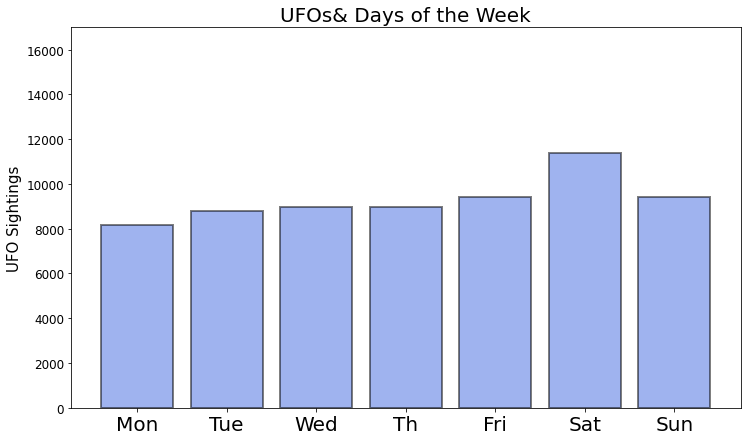

In [85]:
day_of_week = ["Mon", "Tue", "Wed", "Th", "Fri", "Sat", "Sun"]

plt.figure(figsize=(12, 7))
plt.bar(temp.index, temp, color="royalblue", alpha=0.5, edgecolor="black", lw=2)
plt.xticks([0, 1, 2, 3, 4, 5, 6], day_of_week, fontsize=20)
plt.yticks(fontsize=12)
plt.title("UFOs& Days of the Week", fontsize=20)
plt.ylabel("UFO Sightings", fontsize=15)
plt.ylim(0, 17000)
#plt.show()

In [38]:
dfmap = ufo.loc[:,['datetime']]
count = dfmap['datetime'].value_counts()
date = ufo['datetime']
count = pd.DataFrame(count, date)
count = count.rename(columns={' ': 'datetime','datetime': 'count'})
dfmap = dfmap.merge(count, on='datetime', how='left')
count


,count
datetime,
1949-10-10,1
1956-10-10,1
1960-10-10,1
1961-10-10,1
1965-10-10,1
...,...
2013-09-09,14
2013-09-09,14
2013-09-09,14


In [39]:
count=count.T

In [40]:
count

datetime,1949-10-10,1956-10-10,1960-10-10,1961-10-10,1965-10-10,1966-10-10,1966-10-10,1968-10-10,1968-10-10,1970-10-10,1970-10-10,1971-10-10,1972-10-10,1972-10-10,1973-10-10,1974-10-10,1974-10-10,1975-10-10,1976-10-10,1977-10-10,1977-10-10,1978-10-10,1979-10-10,1979-10-10,1979-10-10,1980-10-10,1980-10-10,1980-10-10,1984-10-10,1984-10-10,1984-10-10,1988-10-10,1988-10-10,1988-10-10,1988-10-10,1989-10-10,1989-10-10,1990-10-10,1991-10-10,1991-10-10,...,2011-09-09,2011-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09
count,1,1,1,1,1,2,2,2,2,2,2,1,2,2,1,2,2,1,1,2,2,1,3,3,3,3,3,3,3,3,3,4,4,4,4,2,2,1,2,2,...,14,14,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,14,14,14,14,14,14,14,14,14,14,14,14,14,14


In [56]:
count.dropna()

datetime,1949-10-10,1956-10-10,1960-10-10,1961-10-10,1965-10-10,1966-10-10,1966-10-10,1968-10-10,1968-10-10,1970-10-10,1970-10-10,1971-10-10,1972-10-10,1972-10-10,1973-10-10,1974-10-10,1974-10-10,1975-10-10,1976-10-10,1977-10-10,1977-10-10,1978-10-10,1979-10-10,1979-10-10,1979-10-10,1980-10-10,1980-10-10,1980-10-10,1984-10-10,1984-10-10,1984-10-10,1988-10-10,1988-10-10,1988-10-10,1988-10-10,1989-10-10,1989-10-10,1990-10-10,1991-10-10,1991-10-10,...,2011-09-09,2011-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2012-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09,2013-09-09
count,1,1,1,1,1,2,2,2,2,2,2,1,2,2,1,2,2,1,1,2,2,1,3,3,3,3,3,3,3,3,3,4,4,4,4,2,2,1,2,2,...,14,14,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,14,14,14,14,14,14,14,14,14,14,14,14,14,14


In [48]:
train_start

array([], dtype=int64)

In [57]:
df=count
train_start = df.columns.get_loc('1920-01-01')
train_stop = df.columns.get_loc('2012-09-09')
test_stop = df.columns.get_loc('2013-01-01')
train_columns = df.loc[:, ['1920-01-01','2012-09-09']].columns.tolist()
test_columns = df.loc[:, [('2012-09-09' + 1),'2013-01-01']].columns.tolist()

date_columns = df.loc[:, [train_start:test_stop]].columns.tolist()

df[date_columns] = df[date_columns].replace(0, np.nan)
df[date_columns] = df[date_columns].dropna()

df_train = df[train_columns].median().T
df_test = df[test_columns].median().T

#
model = ARIMA(df_train, order=(5,1,0))
model_fit = model.fit()
print(model_fit.summary())

KeyError: ignored